In [2]:

from google.colab import drive
drive.mount('/content/drive')
import os
os.chdir('/content/drive/My Drive/cs445-final')
!pwd


Mounted at /content/drive
/content/drive/My Drive/cs445-final


# Pre-Processing

In [ ]:
import h5py
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import os

def extract_and_save(mat_file_path, save_dir='./nyu-organised'):

    images_dir = os.path.join(save_dir, 'images')
    depths_dir = os.path.join(save_dir, 'depths')
    labels_dir = os.path.join(save_dir, 'labels')

    os.makedirs(images_dir, exist_ok=True)
    os.makedirs(depths_dir, exist_ok=True)
    os.makedirs(labels_dir, exist_ok=True)

    with h5py.File(mat_file_path, 'r') as f:
        num_images = f['images'].shape[0]
        for i in range(num_images):
            # Extract RGB image
            img = f['images'][i]
            img_transposed = img.transpose(2, 1, 0)
            img_uint8 = img_transposed.astype(np.uint8)
            img_pil = Image.fromarray(img_uint8)
            img_pil.save(os.path.join(images_dir, f'image_{i}.png'))

            # Extract depth map
            depth = f['depths'][i]
            depth_transposed = depth.transpose(1, 0)
            depth_float = depth_transposed.astype(np.float32)
            depth_min = depth_float.min()
            depth_max = depth_float.max()
            if depth_max - depth_min > 0:
                depth_normalized = (depth_float - depth_min) / (depth_max - depth_min)
            else:
                depth_normalized = depth_float - depth_min
            depth_uint8 = (depth_normalized * 255).astype(np.uint8)
            depth_pil = Image.fromarray(depth_uint8)
            depth_pil = depth_pil.convert("L")
            depth_pil.save(os.path.join(depths_dir, f'depth_{i}.png'))

            # Extract segmentation label
            label = f['labels'][i]
            label_transposed = label.transpose(1, 0)
            label_uint8 = label_transposed.astype(np.uint8)
            label_pil = Image.fromarray(label_uint8, mode='L')
            label_pil.save(os.path.join(labels_dir, f'label_{i}.png'))

def inspect_mat_file(mat_file_path):

    with h5py.File(mat_file_path, 'r') as f:
        print("Keys in the .mat file:")
        print(list(f.keys()))

        if 'images' in f:
            images = f['images']
            print(f"'images' shape: {images.shape}")  # Expected: (num_images, 3, 640, 480)
            print(f"'images' dtype: {images.dtype}")
            sample_image = images[0]
            print(f"Sample pixel values (channel-wise) at [100, 100]:")
            print(f"Red channel [100, 100]: {sample_image[0, 100, 100]}")
            print(f"Green channel [100, 100]: {sample_image[1, 100, 100]}")
            print(f"Blue channel [100, 100]: {sample_image[2, 100, 100]}")

        if 'depths' in f:
            depths = f['depths']
            print(f"'depths' shape: {depths.shape}")  # Expected: (num_images, 640, 480)
            print(f"'depths' dtype: {depths.dtype}")
            sample_depth = depths[0]
            print(f"Sample depth value at [100, 100]: {sample_depth[100, 100]}")

        if 'labels' in f:
            labels = f['labels']
            print(f"'labels' shape: {labels.shape}")  # Expected: (num_images, 640, 480)
            print(f"'labels' dtype: {labels.dtype}")
            sample_label = labels[0]
            print(f"Sample label value at [100, 100]: {sample_label[100, 100]}")

def main():
    # Path to your NYU Depth V2 labeled .mat file
    mat_file = './nyu_depth_v2_labeled.mat'  # Update this path accordingly

    # Inspect the .mat file structure and sample data
    print("Inspecting the .mat file structure and sample data:")
    inspect_mat_file(mat_file)

    # Extract and save all images, depth maps, and labels
    print("\nExtracting and saving images, depth maps, and segmentation labels...")
    extract_and_save(mat_file_path=mat_file, save_dir='./organised-nyu')
    print("Extraction and saving completed.")

if __name__ == "__main__":
    main()


Inspecting the .mat file structure and sample data:
Keys in the .mat file:
['#refs#', '#subsystem#', 'accelData', 'depths', 'images', 'instances', 'labels', 'names', 'namesToIds', 'rawDepthFilenames', 'rawDepths', 'rawRgbFilenames', 'sceneTypes', 'scenes']
'images' shape: (1449, 3, 640, 480)
'images' dtype: uint8
Sample pixel values (channel-wise) at [100, 100]:
Red channel [100, 100]: 152
Green channel [100, 100]: 150
Blue channel [100, 100]: 152
'depths' shape: (1449, 640, 480)
'depths' dtype: float32
Sample depth value at [100, 100]: 3.0012755393981934
'labels' shape: (1449, 640, 480)
'labels' dtype: uint16
Sample label value at [100, 100]: 21

Extracting and saving images, depth maps, and segmentation labels...
Extraction and saving completed.


In [ ]:
import h5py
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import os
import shutil

def extract_and_save(mat_file_path, save_dir='./nyu-organised'):

    images_dir = os.path.join(save_dir, 'images')
    depths_dir = os.path.join(save_dir, 'depths')
    labels_dir = os.path.join(save_dir, 'labels')

    os.makedirs(images_dir, exist_ok=True)
    os.makedirs(depths_dir, exist_ok=True)
    os.makedirs(labels_dir, exist_ok=True)

    with h5py.File(mat_file_path, 'r') as f:
        num_images = f['images'].shape[0]
        for i in range(num_images):
            # Extract RGB image
            img = f['images'][i]
            img_transposed = img.transpose(2, 1, 0)
            img_uint8 = img_transposed.astype(np.uint8)
            img_pil = Image.fromarray(img_uint8)
            img_pil.save(os.path.join(images_dir, f'image_{i}.png'))

            # Extract depth map
            depth = f['depths'][i]
            depth_transposed = depth.transpose(1, 0)
            depth_float = depth_transposed.astype(np.float32)
            depth_min = depth_float.min()
            depth_max = depth_float.max()
            if depth_max - depth_min > 0:
                depth_normalized = (depth_float - depth_min) / (depth_max - depth_min)
            else:
                depth_normalized = depth_float - depth_min
            depth_uint8 = (depth_normalized * 255).astype(np.uint8)
            depth_pil = Image.fromarray(depth_uint8)
            depth_pil = depth_pil.convert("L")
            depth_pil.save(os.path.join(depths_dir, f'depth_{i}.png'))

            # Extract segmentation label
            label = f['labels'][i]
            label_transposed = label.transpose(1, 0)
            label_uint8 = label_transposed.astype(np.uint8)
            label_pil = Image.fromarray(label_uint8, mode='L')
            label_pil.save(os.path.join(labels_dir, f'label_{i}.png'))

def split_data(save_dir='./nyu-organised', train_ratio=0.8, val_ratio=0.1, test_ratio=0.1):

    images_dir = os.path.join(save_dir, 'images')
    depths_dir = os.path.join(save_dir, 'depths')
    labels_dir = os.path.join(save_dir, 'labels')

    train_dir = os.path.join(save_dir, 'train')
    val_dir = os.path.join(save_dir, 'val')
    test_dir = os.path.join(save_dir, 'test')

    train_images_dir = os.path.join(train_dir, 'images')
    train_depths_dir = os.path.join(train_dir, 'depths')
    train_labels_dir = os.path.join(train_dir, 'labels')

    val_images_dir = os.path.join(val_dir, 'images')
    val_depths_dir = os.path.join(val_dir, 'depths')
    val_labels_dir = os.path.join(val_dir, 'labels')

    test_images_dir = os.path.join(test_dir, 'images')
    test_depths_dir = os.path.join(test_dir, 'depths')
    test_labels_dir = os.path.join(test_dir, 'labels')

    os.makedirs(train_images_dir, exist_ok=True)
    os.makedirs(train_depths_dir, exist_ok=True)
    os.makedirs(train_labels_dir, exist_ok=True)

    os.makedirs(val_images_dir, exist_ok=True)
    os.makedirs(val_depths_dir, exist_ok=True)
    os.makedirs(val_labels_dir, exist_ok=True)

    os.makedirs(test_images_dir, exist_ok=True)
    os.makedirs(test_depths_dir, exist_ok=True)
    os.makedirs(test_labels_dir, exist_ok=True)

    image_files = sorted([f for f in os.listdir(images_dir) if f.startswith('image_') and f.endswith('.png')],
                         key=lambda x: int(x.split('_')[1].split('.')[0]))

    num_total = len(image_files)
    num_train = int(num_total * train_ratio)
    num_val = int(num_total * val_ratio)
    num_test = num_total - num_train - num_val

    train_files = image_files[:num_train]
    val_files = image_files[num_train:num_train + num_val]
    test_files = image_files[num_train + num_val:]

    for file_list, img_dst, depth_dst, label_dst in [
        (train_files, train_images_dir, train_depths_dir, train_labels_dir),
        (val_files, val_images_dir, val_depths_dir, val_labels_dir),
        (test_files, test_images_dir, test_depths_dir, test_labels_dir)
    ]:
        for img_file in file_list:
            idx = img_file.split('_')[1].split('.')[0]
            depth_file = f'depth_{idx}.png'
            label_file = f'label_{idx}.png'

            shutil.copy(os.path.join(images_dir, img_file), os.path.join(img_dst, img_file))
            shutil.copy(os.path.join(depths_dir, depth_file), os.path.join(depth_dst, depth_file))
            shutil.copy(os.path.join(labels_dir, label_file), os.path.join(label_dst, label_file))

def inspect_mat_file(mat_file_path):

    with h5py.File(mat_file_path, 'r') as f:
        print("Keys in the .mat file:")
        print(list(f.keys()))

        # Inspect the 'images' dataset
        if 'images' in f:
            images = f['images']
            print(f"'images' shape: {images.shape}")  # Expected: (num_images, 3, 640, 480)
            print(f"'images' dtype: {images.dtype}")
            # Inspect a specific image's pixel values
            sample_image = images[0]
            print(f"Sample pixel values (channel-wise) at [100, 100]:")
            print(f"Red channel [100, 100]: {sample_image[0, 100, 100]}")
            print(f"Green channel [100, 100]: {sample_image[1, 100, 100]}")
            print(f"Blue channel [100, 100]: {sample_image[2, 100, 100]}")

        # Inspect the 'depths' dataset
        if 'depths' in f:
            depths = f['depths']
            print(f"'depths' shape: {depths.shape}")  # Expected: (num_images, 640, 480)
            print(f"'depths' dtype: {depths.dtype}")
            # Inspect a specific depth value
            sample_depth = depths[0]
            print(f"Sample depth value at [100, 100]: {sample_depth[100, 100]}")

        # Inspect the 'labels' dataset
        if 'labels' in f:
            labels = f['labels']
            print(f"'labels' shape: {labels.shape}")  # Expected: (num_images, 640, 480)
            print(f"'labels' dtype: {labels.dtype}")
            # Inspect a specific label value
            sample_label = labels[0]
            print(f"Sample label value at [100, 100]: {sample_label[100, 100]}")

def visualize_loaded_data(pred, gt_depth, gt_label, index=0):
    """
    Visualizes the loaded RGB image, its corresponding depth map, and segmentation label.

    Args:
        pred (np.ndarray): Array of loaded RGB images.
        gt_depth (np.ndarray): Array of loaded depth maps.
        gt_label (np.ndarray): Array of loaded segmentation labels.
        index (int): Index of the image to visualize.
    """
    plt.figure(figsize=(18, 6))

    # RGB Image
    plt.subplot(1, 3, 1)
    plt.imshow(pred[index])
    plt.title(f"RGB Image {index}")
    plt.axis('off')

    # Depth Map
    plt.subplot(1, 3, 2)
    depth = gt_depth[index, :, :, 0]
    plt.imshow(depth, cmap='plasma')
    plt.title(f"Depth Map {index}")
    plt.axis('off')

    # Segmentation Label
    plt.subplot(1, 3, 3)
    label = gt_label[index, :, :, 0]
    plt.imshow(label, cmap='jet')  # Use a colormap suitable for labels
    plt.title(f"Segmentation Label {index}")
    plt.axis('off')

    plt.show()

def main():
    # Path to your NYU Depth V2 labeled .mat file
    mat_file = './nyu_depth_v2_labeled.mat'  # Update this path accordingly

    # Inspect the .mat file structure and sample data
    print("Inspecting the .mat file structure and sample data:")
    inspect_mat_file(mat_file)

    # Extract and save all images, depth maps, and labels
    print("\nExtracting and saving images, depth maps, and segmentation labels...")
    extract_and_save(mat_file_path=mat_file, save_dir='./nyu-organised')
    print("Extraction completed.")

    # Split the data into train, val, and test
    print("\nSplitting data into train, validation, and test sets...")
    split_data(save_dir='./nyu-organised', train_ratio=0.7, val_ratio=0.15, test_ratio=0.15)
    print("Data splitting completed.")

if __name__ == "__main__":
    main()


#Model Training

In [3]:
import os
import torch
from torch.utils.data import Dataset
from torchvision import transforms as T
from PIL import Image
import numpy as np
import cv2


def enhance_contrast(image):
    image = np.array(image)
    lab = cv2.cvtColor(image, cv2.COLOR_RGB2LAB)
    l, a, b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    l = clahe.apply(l)
    enhanced_lab = cv2.merge((l, a, b))
    enhanced_image = cv2.cvtColor(enhanced_lab, cv2.COLOR_LAB2RGB)
    return Image.fromarray(enhanced_image)

def adaptive_gamma_correction(image, gamma=1.5):
    image = np.array(image, dtype=np.float32) / 255.0
    corrected = np.power(image, gamma)
    return Image.fromarray((corrected * 255).astype(np.uint8))

# Dataset Loader
class NYUDv2Dataset(Dataset):
    def __init__(self, root_dir, split='train', transform=None):
        """
        Args:
            root_dir (str): Root directory of the dataset.
            split (str): Dataset split ('train', 'val', or 'test').
            transform (callable, optional): Transformations for data preprocessing.
        """
        self.root_dir = root_dir
        self.split = split
        self.transform = transform
        self.image_dir = os.path.join(root_dir, split, 'images')
        self.depth_dir = os.path.join(root_dir, split, 'depths')
        self.label_dir = os.path.join(root_dir, split, 'labels')

        # Match filenames based on numeric IDs
        self.file_ids = sorted([
            f.split('_')[1].split('.')[0]
            for f in os.listdir(self.image_dir)
            if f.startswith('image_')
        ])

    def __len__(self):
        return len(self.file_ids)

    def __getitem__(self, idx):
        # Match file IDs for image, depth, and label
        file_id = self.file_ids[idx]
        img_path = os.path.join(self.image_dir, f'image_{file_id}.png')
        depth_path = os.path.join(self.depth_dir, f'depth_{file_id}.png')
        label_path = os.path.join(self.label_dir, f'label_{file_id}.png')

        # Load image, depth, and label
        image = Image.open(img_path).convert("RGB")
        image = enhance_contrast(image)

        depth = Image.open(depth_path)
        depth = np.array(depth, dtype=np.float32) / 1000.0  # Normalize depth to meters
        label = Image.open(label_path)
        label = np.array(label, dtype=np.int64)  # Convert to integer labels

        # Apply transformations
        if self.transform:
            image, depth, label = self.transform(image, depth, label)

        return image, depth, label

from torchvision.transforms.functional import pil_to_tensor

class NYUDTransform:
    def __init__(self, target_size=(256, 256)):
        self.image_transform = T.Compose([
            T.Resize(target_size),
            T.ToTensor(),
            T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
        ])
        self.depth_transform = T.Compose([
            T.Resize(target_size),
            T.ToTensor()
        ])
        self.label_transform = T.Compose([
            T.Resize(target_size, interpolation=T.InterpolationMode.NEAREST),
            lambda x: torch.tensor(np.array(x, dtype=np.int64))
        ])

    def __call__(self, image, depth, label):
        if isinstance(depth, np.ndarray):
            depth = Image.fromarray(depth.astype(np.float32))
        if isinstance(label, np.ndarray):
            label = Image.fromarray(label.astype(np.uint8))
        # Apply transformations
        image = self.image_transform(image)
        depth = self.depth_transform(depth).squeeze(0)
        label = self.label_transform(label)
        return image, depth, label



Image shape: torch.Size([3, 256, 256])
Depth shape: torch.Size([256, 256])
Label shape: torch.Size([256, 256])


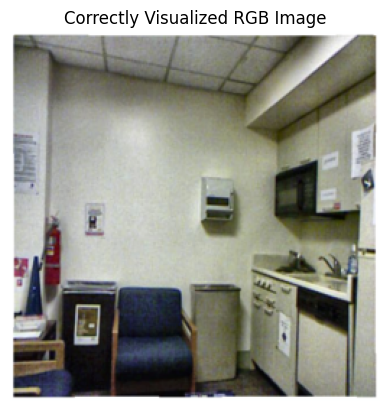

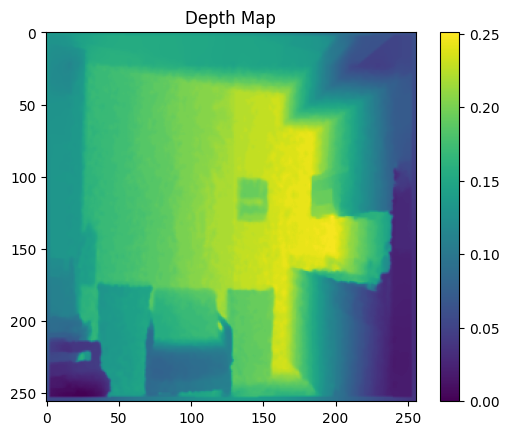

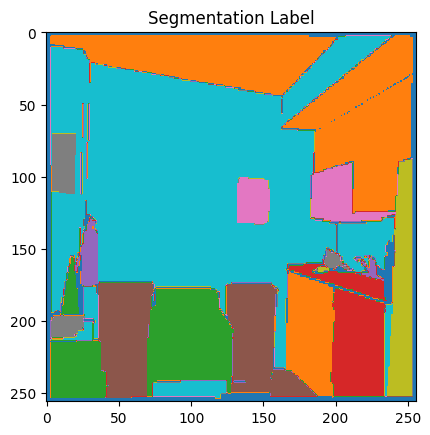

In [4]:
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader

root_dir = 'nyu-organised' #IF you ever save proces imgs under different dir change this with the generic setup ypu wont need it

def visualize_image(tensor, mean, std):
    img = tensor.clone().detach()
    img = img.permute(1, 2, 0).cpu().numpy()
    img = (img * std) + mean
    img = np.clip(img, 0, 1)

    plt.imshow(img)
    plt.title("Correctly Visualized RGB Image")
    plt.axis("off")
    plt.show()

transform = NYUDTransform(target_size=(256, 256))
dataset = NYUDv2Dataset(root_dir=root_dir, split='train', transform=transform)
train_loader = DataLoader(dataset, batch_size=8, shuffle=True, num_workers=4)

val_dataset = NYUDv2Dataset(root_dir=root_dir, split='val', transform=transform)
val_loader = DataLoader(val_dataset, batch_size=16, shuffle=False, num_workers=4)
image, depth, label = dataset[0]

print(f"Image shape: {image.shape}")  # Should be [3, 256, 256]
print(f"Depth shape: {depth.shape}")  # Should be [256, 256]
print(f"Label shape: {label.shape}")  # Should be [256, 256]

mean = [0.485, 0.456, 0.406]
std = [0.229, 0.224, 0.225]

visualize_image(image, mean, std)

plt.imshow(depth.numpy(), cmap='viridis')
plt.title("Depth Map")
plt.colorbar()
plt.show()

plt.imshow(label.numpy(), cmap='tab10')
plt.title("Segmentation Label")
plt.show()


In [44]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import models

class MultiScaleFeatureExtractor(nn.Module):
    def __init__(self, pretrained=True):
        super(MultiScaleFeatureExtractor, self).__init__()
        resnet = models.resnet50(weights=models.ResNet50_Weights.IMAGENET1K_V1 if pretrained else None)
        self.layer1 = nn.Sequential(resnet.conv1, resnet.bn1, resnet.relu, resnet.maxpool)  # 64x64
        self.layer2 = resnet.layer1  # 64x64
        self.layer3 = resnet.layer2  # 32x32
        self.layer4 = resnet.layer3  # 16x16
        self.layer5 = resnet.layer4  # 8x8

        self.dilated_layer4 = nn.Conv2d(1024, 1024, kernel_size=3, padding=2, dilation=2)  # Dilation for layer4
        self.dilated_layer5 = nn.Conv2d(2048, 2048, kernel_size=3, padding=4, dilation=4)  # Dilation for layer5

        # Reduce channels
        self.reduce_layer1 = nn.Conv2d(64, 128, kernel_size=1)
        self.reduce_layer2 = nn.Conv2d(256, 128, kernel_size=1)
        self.reduce_layer3 = nn.Conv2d(512, 128, kernel_size=1)
        self.reduce_layer4 = nn.Conv2d(1024, 128, kernel_size=1)
        self.reduce_layer5 = nn.Conv2d(2048, 128, kernel_size=1)

    def forward(self, x):
        features = []
        x1 = self.layer1(x)  # 64x64
        x2 = self.layer2(x1)  # 64x64
        x3 = self.layer3(x2)  # 32x32
        x4 = self.layer4(x3)  # 16x16
        x5 = self.layer5(x4)  # 8x8

        # Apply dilated convolutions to higher layers
        x4_dilated = F.relu(self.dilated_layer4(x4))  # 16x16
        x5_dilated = F.relu(self.dilated_layer5(x5))  # 8x8

        # Reduce dimensions and align all feature maps to 64x64
        x1 = F.interpolate(self.reduce_layer1(x1), size=(64, 64), mode='bilinear', align_corners=False)
        x2 = F.interpolate(self.reduce_layer2(x2), size=(64, 64), mode='bilinear', align_corners=False)
        x3 = F.interpolate(self.reduce_layer3(x3), size=(64, 64), mode='bilinear', align_corners=False)
        x4 = F.interpolate(self.reduce_layer4(x4_dilated), size=(64, 64), mode='bilinear', align_corners=False)
        x5 = F.interpolate(self.reduce_layer5(x5_dilated), size=(64, 64), mode='bilinear', align_corners=False)

        features = torch.cat([x1, x2, x3, x4, x5], dim=1)  # Concatenate features
        return features, x1, x2



In [6]:
class DepthDecoder(nn.Module):
    def __init__(self, in_channels, out_channels=1):
        super(DepthDecoder, self).__init__()
        self.upsample1 = nn.ConvTranspose2d(in_channels, 256, kernel_size=4, stride=2, padding=1)  # 64x64 -> 128x128
        self.bn1 = nn.BatchNorm2d(256)
        self.upsample2 = nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1)  # 128x128 -> 256x256
        self.bn2 = nn.BatchNorm2d(128)
        self.output_layer = nn.Conv2d(128, out_channels, kernel_size=3, padding=1)  # Final depth map

    def forward(self, x):
        x = F.relu(self.bn1(self.upsample1(x)))
        x = F.relu(self.bn2(self.upsample2(x)))
        x = self.output_layer(x)  # No activation for raw depth map
        return x


In [36]:
class DepthDecoderWithAttention(nn.Module):
    def __init__(self, in_channels, seg_channels, out_channels=1):

        super(DepthDecoderWithAttention, self).__init__()

        # Attention mechanism
        self.attention = nn.Sequential(
            nn.Conv2d(seg_channels, 128, kernel_size=1),  # Reduce channels of segmentation features
            nn.ReLU(),
            nn.Conv2d(128, 1, kernel_size=1),  # Attention map (1 channel)
            nn.Sigmoid()
        )

        # Decoder layers
        self.upsample1 = nn.Sequential(
            nn.Conv2d(in_channels, 256, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=False)
        )
        self.upsample2 = nn.Sequential(
            nn.Conv2d(256, 128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=False)
        )
        self.output_layer = nn.Conv2d(128, out_channels, kernel_size=3, padding=1)

    def forward(self, depth_features, seg_features):
        attention_map = self.attention(seg_features)

        depth_features = depth_features * attention_map

        x = self.upsample1(depth_features)
        x = self.upsample2(x)
        depth_output = self.output_layer(x)

        return depth_output


In [7]:
class AttentionInteractionLayer(nn.Module):
    def __init__(self, in_channels):
        super(AttentionInteractionLayer, self).__init__()
        self.query = nn.Conv2d(in_channels, in_channels // 8, kernel_size=1)
        self.key = nn.Conv2d(in_channels, in_channels // 8, kernel_size=1)
        self.value = nn.Conv2d(in_channels, in_channels, kernel_size=1)
        self.softmax = nn.Softmax(dim=-1)

    def forward(self, task_features, auxiliary_features):
        B, C, H, W = task_features.shape
        query = self.query(task_features).view(B, -1, H * W).permute(0, 2, 1)  # (B, HW, C)
        key = self.key(auxiliary_features).view(B, -1, H * W)  # (B, C, HW)
        value = self.value(auxiliary_features).view(B, -1, H * W).permute(0, 2, 1)  # (B, HW, C)

        attention = self.softmax(torch.bmm(query, key))  # (B, HW, HW)
        out = torch.bmm(attention, value).permute(0, 2, 1).view(B, C, H, W)  # (B, C, H, W)
        return out + task_features  # Residual connection


In [47]:
class DepthDecoderWithSkipConnections(nn.Module):
    def __init__(self, in_channels, out_channels=1, skip_channels=128):

        super(DepthDecoderWithSkipConnections, self).__init__()
        self.upsample1 = nn.ConvTranspose2d(in_channels, 256, kernel_size=4, stride=2, padding=1)
        self.bn1 = nn.BatchNorm2d(256)
        self.upsample2 = nn.ConvTranspose2d(256 + skip_channels, 128, kernel_size=4, stride=2, padding=1)
        self.bn2 = nn.BatchNorm2d(128)
        self.output_layer = nn.Conv2d(128 + skip_channels, out_channels, kernel_size=3, padding=1)

    def forward(self, x, skip1, skip2):

        x = F.relu(self.bn1(self.upsample1(x)))

        # Resize skip1 to match x
        skip1_resized = F.interpolate(skip1, size=x.shape[2:], mode="bilinear", align_corners=False)
        x = torch.cat((x, skip1_resized), dim=1)

        x = F.relu(self.bn2(self.upsample2(x)))

        # Resize skip2 to match x
        skip2_resized = F.interpolate(skip2, size=x.shape[2:], mode="bilinear", align_corners=False)
        x = torch.cat((x, skip2_resized), dim=1)

        x = self.output_layer(x)
        return x


In [9]:
class SegmentationDecoder(nn.Module):
    def __init__(self, in_channels, num_classes):

        super(SegmentationDecoder, self).__init__()
        self.upsample1 = nn.ConvTranspose2d(in_channels, 256, kernel_size=4, stride=2, padding=1)  # 64x64 -> 128x128
        self.bn1 = nn.BatchNorm2d(256)
        self.upsample2 = nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1)  # 128x128 -> 256x256
        self.bn2 = nn.BatchNorm2d(128)
        self.output_layer = nn.Conv2d(128, num_classes, kernel_size=3, padding=1)

    def forward(self, x):
        x = F.relu(self.bn1(self.upsample1(x)))
        x = F.relu(self.bn2(self.upsample2(x)))
        x = self.output_layer(x)  # No activation (CrossEntropyLoss applies softmax)
        return x


In [10]:
class TaskInteractionLayer(nn.Module):
    def __init__(self, in_channels, out_channels):

        super(TaskInteractionLayer, self).__init__()
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=1)
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1)
        self.bn = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU()

    def forward(self, task_features, auxiliary_features):

        combined_features = torch.cat([task_features, auxiliary_features], dim=1)
        x = self.conv1(combined_features)
        x = self.relu(self.bn(self.conv2(x)))
        return x


In [48]:
class FullMTINet(nn.Module):
    def __init__(self, num_classes=251, pretrained=True):

        super(FullMTINet, self).__init__()
        self.feature_extractor = MultiScaleFeatureExtractor(pretrained=pretrained)

        # Task Interaction Layers
        self.interaction_seg = TaskInteractionLayer(640 + 640, 640)
        self.interaction_depth = TaskInteractionLayer(640 + 640, 640)
        self.interaction_edge = TaskInteractionLayer(640 + 640, 640)

        # Decoders
        self.segmentation_decoder = SegmentationDecoder(in_channels=640, num_classes=num_classes)
        self.depth_decoder = DepthDecoderWithSkipConnections(in_channels=640, out_channels=1)
        self.edge_decoder = DepthDecoder(in_channels=640, out_channels=1)  # Edge map is binary (1 channel)

        # Auxiliary supervision
        self.aux_edge_layer = nn.Conv2d(640, 1, kernel_size=1)

    def forward(self, x):
        # Multi-scale feature extraction
        combined_features, x1, x2 = self.feature_extractor(x)

        # Skip connections and task-specific interactions
        seg_features = self.interaction_seg(combined_features, combined_features)
        depth_features = self.interaction_depth(combined_features, seg_features)  # Depth benefits from segmentation
        edge_features = self.interaction_edge(combined_features, seg_features)  # Edge benefits from segmentation

        # Decoders
        segmentation_output = self.segmentation_decoder(seg_features)
        depth_output = self.depth_decoder(depth_features, x1, x2)
        edge_output = self.edge_decoder(edge_features)  # Binary edge map output

        return depth_output, segmentation_output, edge_output


In [13]:
def structured_depth_loss(pred, target, alpha=0.5, beta=0.1):

    if target.dim() == 3:
        target = target.unsqueeze(1)
    l1_loss = F.l1_loss(pred, target)

    pred_dx, pred_dy = torch.gradient(pred, dim=(2, 3))
    target_dx, target_dy = torch.gradient(target, dim=(2, 3))

    pred_grad_mag = torch.sqrt(pred_dx**2 + pred_dy**2)
    target_grad_mag = torch.sqrt(target_dx**2 + target_dy**2)

    grad_loss = F.l1_loss(pred_grad_mag, target_grad_mag)

    # Smoothness regularization
    smooth_loss = torch.mean(torch.abs(pred[:, :, :, :-1] - pred[:, :, :, 1:])) + \
                  torch.mean(torch.abs(pred[:, :, :-1, :] - pred[:, :, 1:, :]))

    # Combine losses
    return l1_loss + alpha * grad_loss + beta * smooth_loss


In [92]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
full_mti_net = FullMTINet(num_classes=256, pretrained=True).to(device)

save_dir = "saved_models"
os.makedirs(save_dir, exist_ok=True)

best_val_loss = float('inf')
best_model_path = os.path.join(save_dir, "best_model.pth")

epochs = 30
optimizer = torch.optim.Adam(full_mti_net.parameters(), lr=0.0001)
criterion_depth = nn.L1Loss()
criterion_seg = nn.CrossEntropyLoss()
criterion_edge = nn.BCEWithLogitsLoss()  # Binary Cross Entropy for edge detection

for epoch in range(epochs):
    full_mti_net.train()
    total_depth_loss = 0.0
    total_seg_loss = 0.0
    total_edge_loss = 0.0

    for images, depths, labels in train_loader:
        images, depths, labels = images.to(device), depths.to(device), labels.to(device)

        # Forward pass
        depth_output, segmentation_output, edge_output = full_mti_net(images)

        # Compute losses
        depth_loss = structured_depth_loss(depth_output, depths, alpha=0.8, beta=0.08)

        # depth_loss = criterion_depth(depth_output, depths)
        seg_loss = criterion_seg(segmentation_output, labels)
        edge_loss = criterion_edge(edge_output.squeeze(1), (labels > 0).float())  # Remove channel dimension

        total_loss = depth_loss + seg_loss + 0.5 * edge_loss  # Weight edge loss less

        # Backward pass
        optimizer.zero_grad()
        total_loss.backward()
        optimizer.step()

        total_depth_loss += depth_loss.item()
        total_seg_loss += seg_loss.item()
        total_edge_loss += edge_loss.item()


    print(f"Epoch {epoch+1}/{epochs}: Depth Loss = {total_depth_loss:.4f}, Segmentation Loss = {total_seg_loss:.4f}, Edge Loss = {total_edge_loss:.4f}")
    # Validation
    full_mti_net.eval()
    val_depth_loss = 0.0
    with torch.no_grad():
        for val_images, val_depths, val_labels in val_loader:
            val_images, val_depths, val_labels = val_images.to(device), val_depths.to(device), val_labels.to(device)
            depth_output, segmentation_output, edge_output = full_mti_net(val_images)

            # Compute validation losses
            val_depth_loss += structured_depth_loss(depth_output, val_depths, alpha=0.8, beta=0.1).item()

    avg_val_loss = val_depth_loss / len(val_loader)
    print(f"Validation Loss: {avg_val_loss:.4f}")

    # **Save the Best Model**
    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        torch.save(full_mti_net.state_dict(), best_model_path)
        print(f"New best model saved at epoch {epoch+1} with validation loss: {avg_val_loss:.4f}")

print("Training complete. Best model saved.")


Epoch 1/30: Depth Loss = 10.8484, Segmentation Loss = 363.8998, Edge Loss = 43.1636
Validation Loss: 0.0522
New best model saved at epoch 1 with validation loss: 0.0522
Epoch 2/30: Depth Loss = 6.8414, Segmentation Loss = 251.2276, Edge Loss = 37.3153
Validation Loss: 0.0505
New best model saved at epoch 2 with validation loss: 0.0505
Epoch 3/30: Depth Loss = 6.2440, Segmentation Loss = 212.0794, Edge Loss = 35.3391
Validation Loss: 0.0607
Epoch 4/30: Depth Loss = 5.9777, Segmentation Loss = 181.2877, Edge Loss = 33.2311
Validation Loss: 0.0423
New best model saved at epoch 4 with validation loss: 0.0423
Epoch 5/30: Depth Loss = 5.4429, Segmentation Loss = 155.8849, Edge Loss = 31.0280
Validation Loss: 0.0453
Epoch 6/30: Depth Loss = 5.2451, Segmentation Loss = 137.5054, Edge Loss = 29.1413
Validation Loss: 0.0400
New best model saved at epoch 6 with validation loss: 0.0400
Epoch 7/30: Depth Loss = 4.9587, Segmentation Loss = 123.4775, Edge Loss = 27.8868
Validation Loss: 0.0388
New be

In [18]:
def denormalize_image(image, mean, std):

    image = image.clone().cpu().numpy().transpose(1, 2, 0)  # Convert CHW to HWC
    image = (image * std) + mean  # Reverse normalization
    image = np.clip(image, 0, 1)  # Clip values to [0, 1]
    return image



In [74]:
def visualize_predictions(model, dataset, idx=0, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]):
    model.eval()

    image, depth, label = dataset[idx]
    image = image.unsqueeze(0).to(device)
    depth = depth.to(device)
    label = label.to(device)

    with torch.no_grad():
        depth_output, segmentation_output, edge_output = model(image)

    # Convert tensors to CPU for visualization
    depth_output = depth_output.squeeze().cpu().numpy()  # Predicted depth map
    segmentation_map = torch.argmax(segmentation_output, dim=1).squeeze().cpu().numpy()  # Predicted segmentation map
    edge_output = edge_output.squeeze().cpu().numpy()  # Predicted edge map
    depth = depth.squeeze().cpu().numpy()  # Ground truth depth map
    label = label.squeeze().cpu().numpy()  # Ground truth segmentation label

    denormalized_image = denormalize_image(image.squeeze(), mean, std)

    # Visualize results
    plt.figure(figsize=(18, 12))

    plt.subplot(2, 3, 1)
    plt.imshow(denormalized_image)
    plt.title("Input Image (Denormalized)")

    plt.subplot(2, 3, 2)
    plt.imshow(depth, cmap='viridis')
    plt.title("Ground Truth Depth")

    plt.subplot(2, 3, 3)
    plt.imshow(depth_output, cmap='viridis')
    plt.title("Predicted Depth")

    plt.subplot(2, 3, 4)
    plt.imshow(edge_output, cmap='gray')
    plt.title("Predicted Edges")

    plt.subplot(2, 3, 5)
    plt.imshow(label, cmap='tab20')
    plt.title("Ground Truth Segmentation")

    plt.subplot(2, 3, 6)
    plt.imshow(segmentation_map, cmap='tab20')
    plt.title("Predicted Segmentation")



    plt.tight_layout()
    plt.show()


#Visual Results

Sample 0:


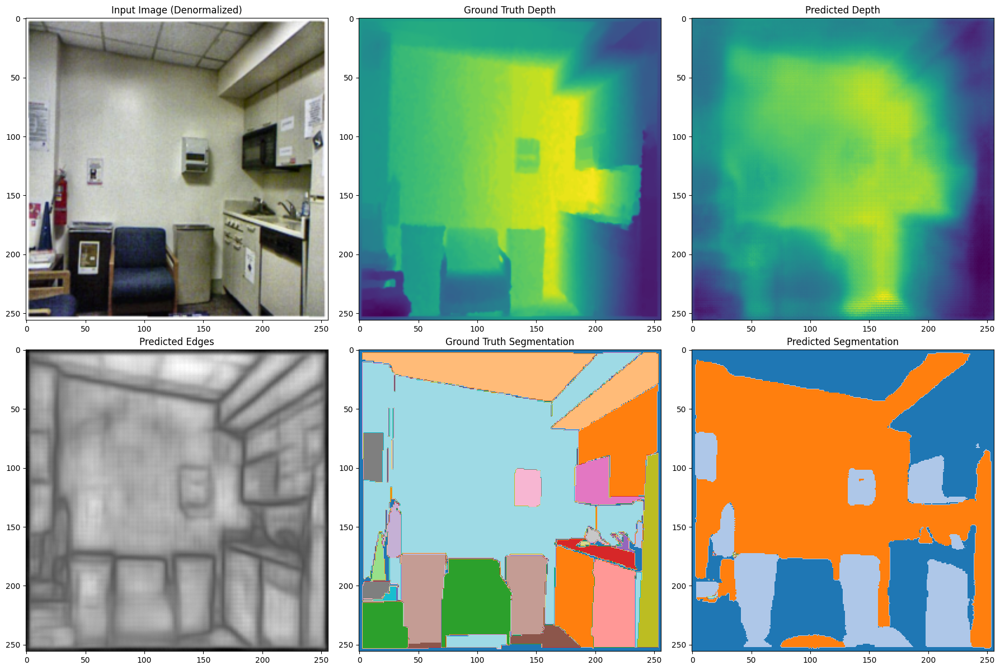

Sample 1:


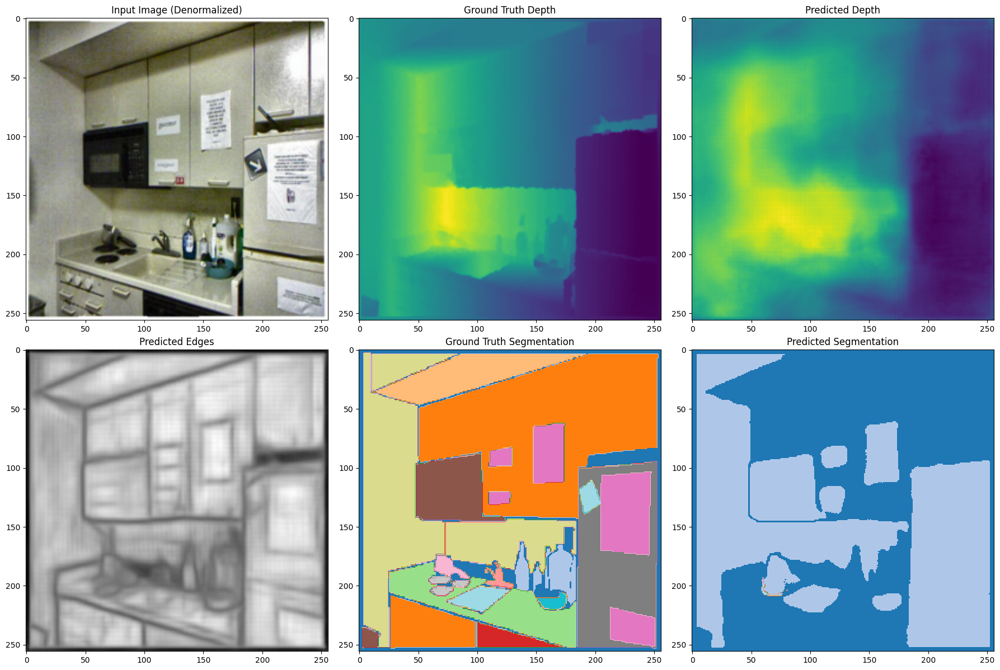

Sample 2:


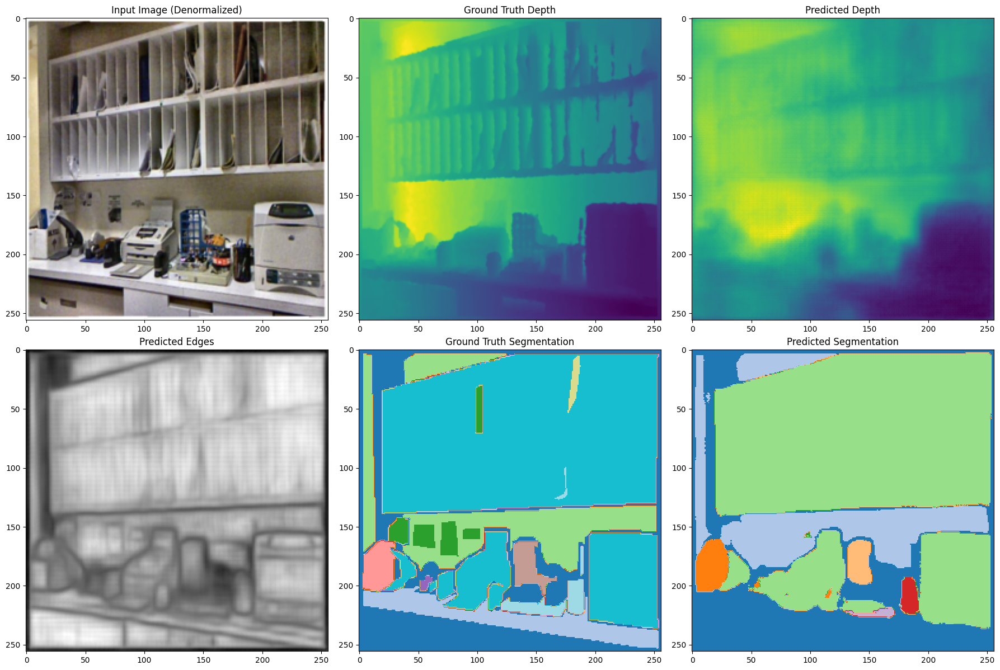

Sample 3:


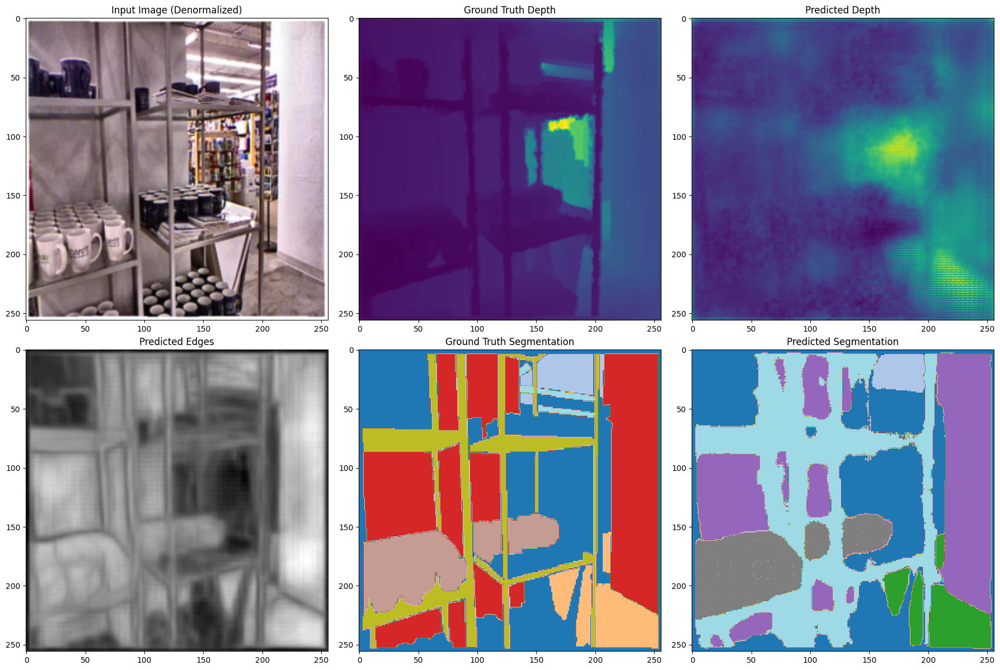

Sample 4:


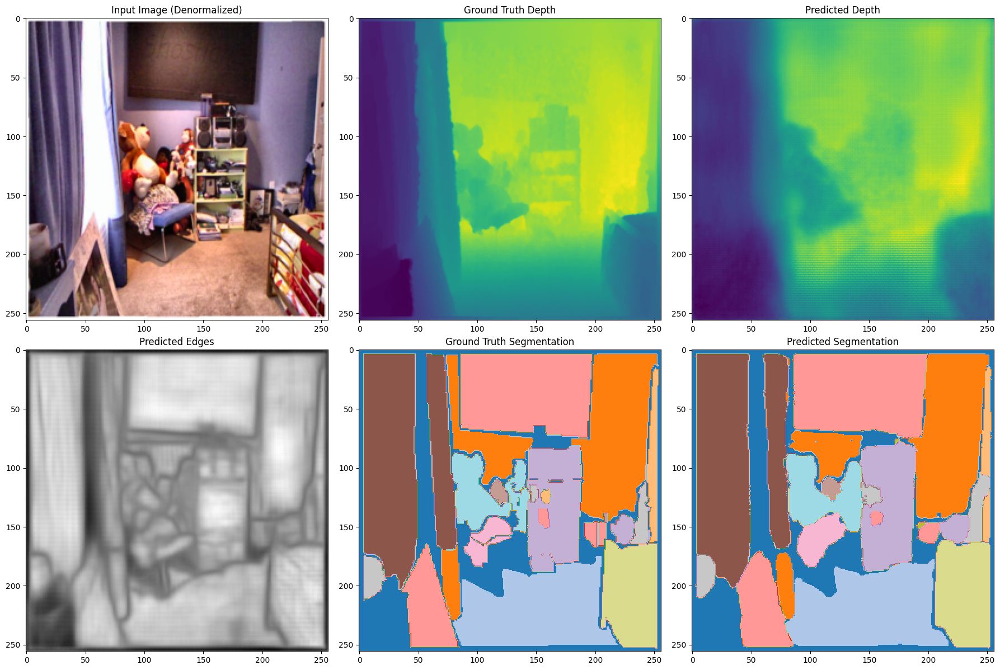

Sample 5:


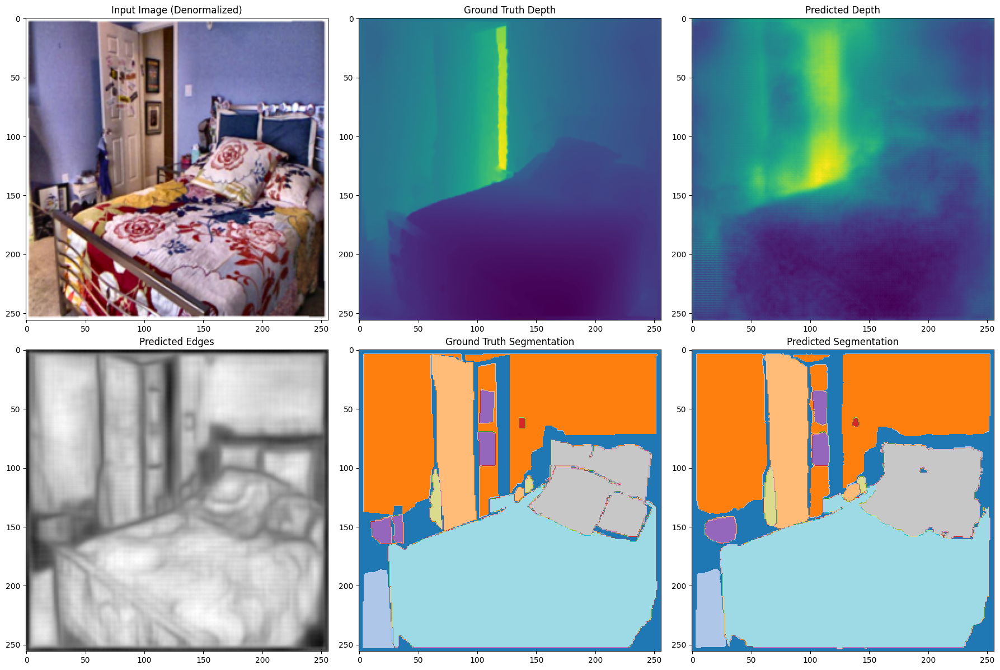

Sample 6:


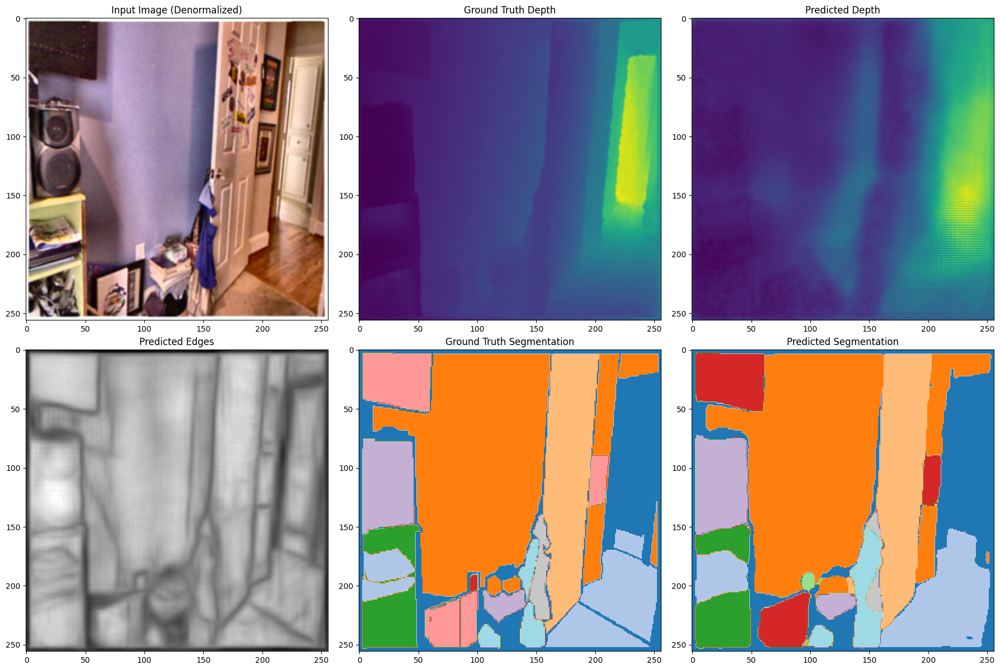

Sample 7:


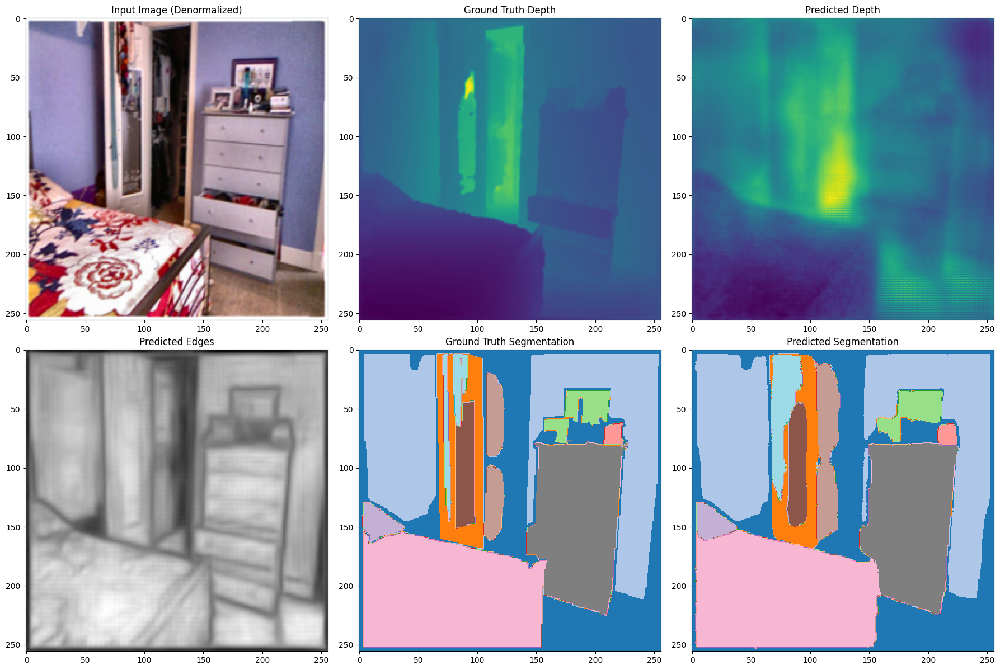

Sample 8:


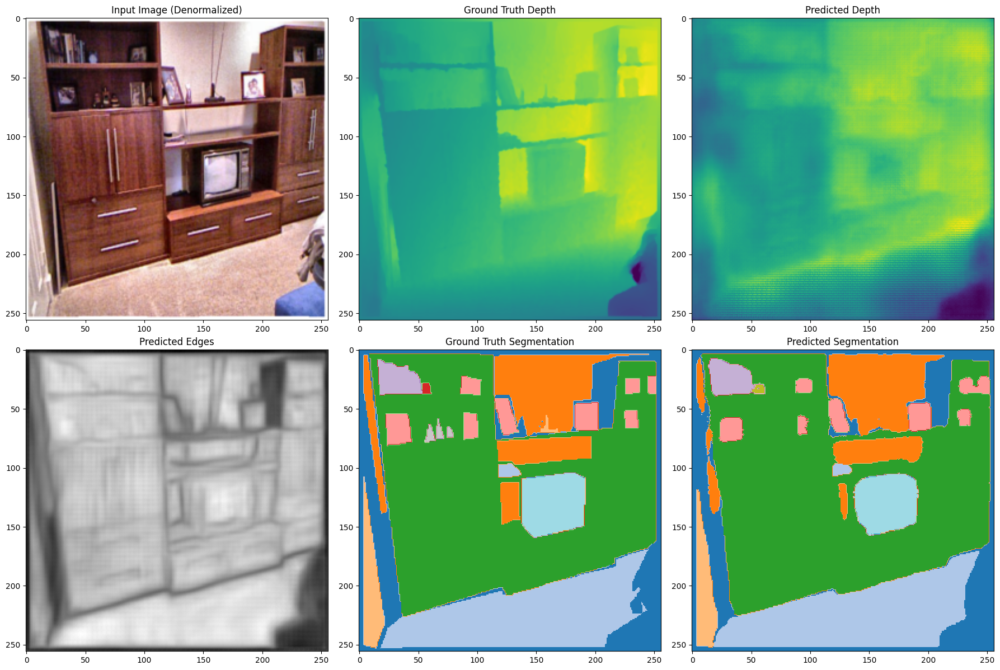

Sample 9:


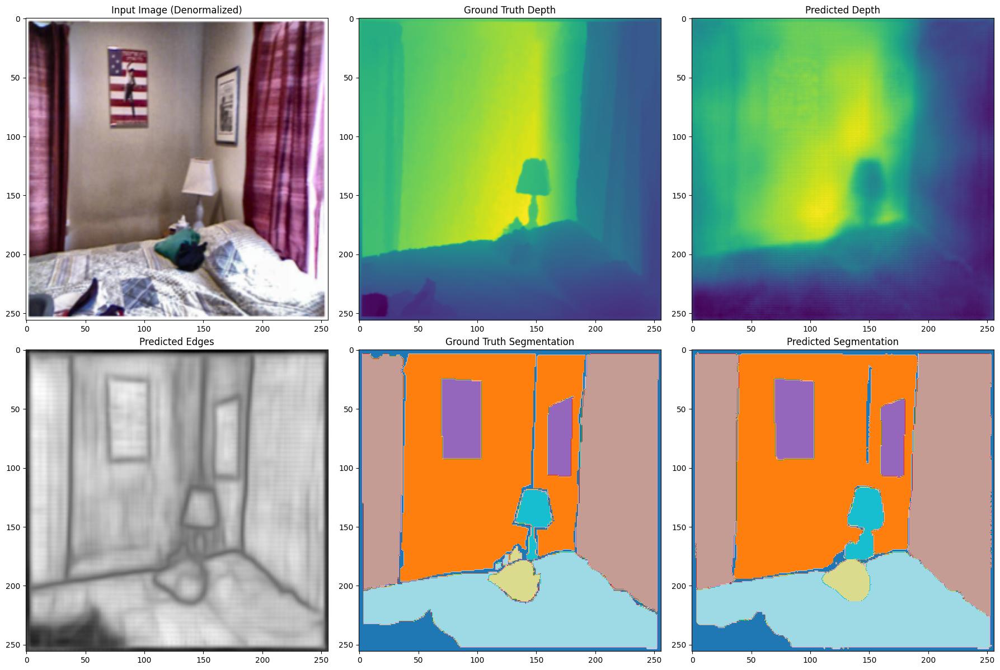

Sample 10:


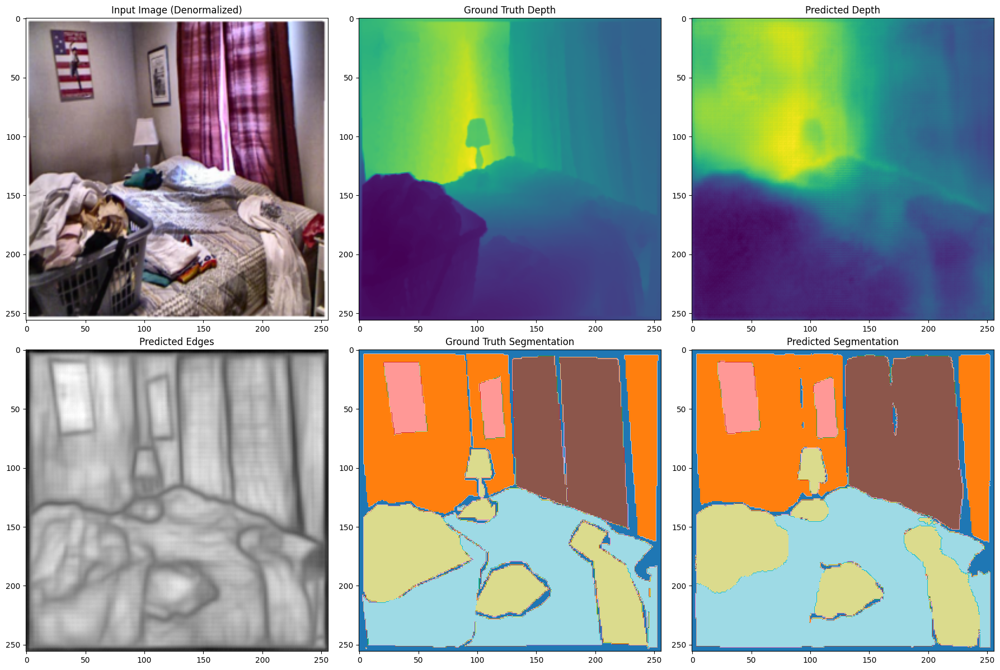

Sample 11:


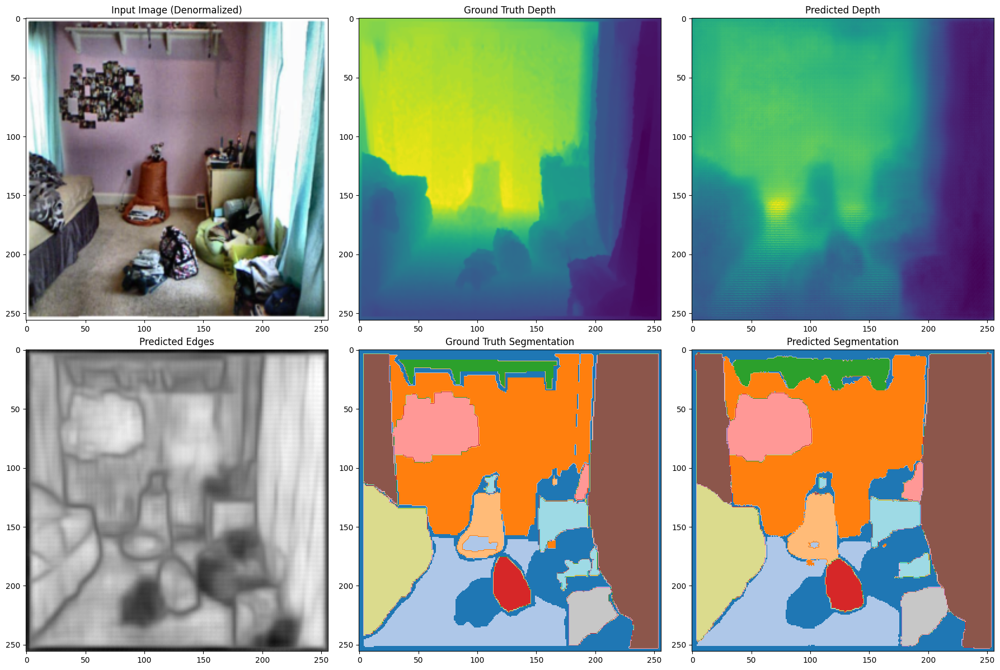

Sample 12:


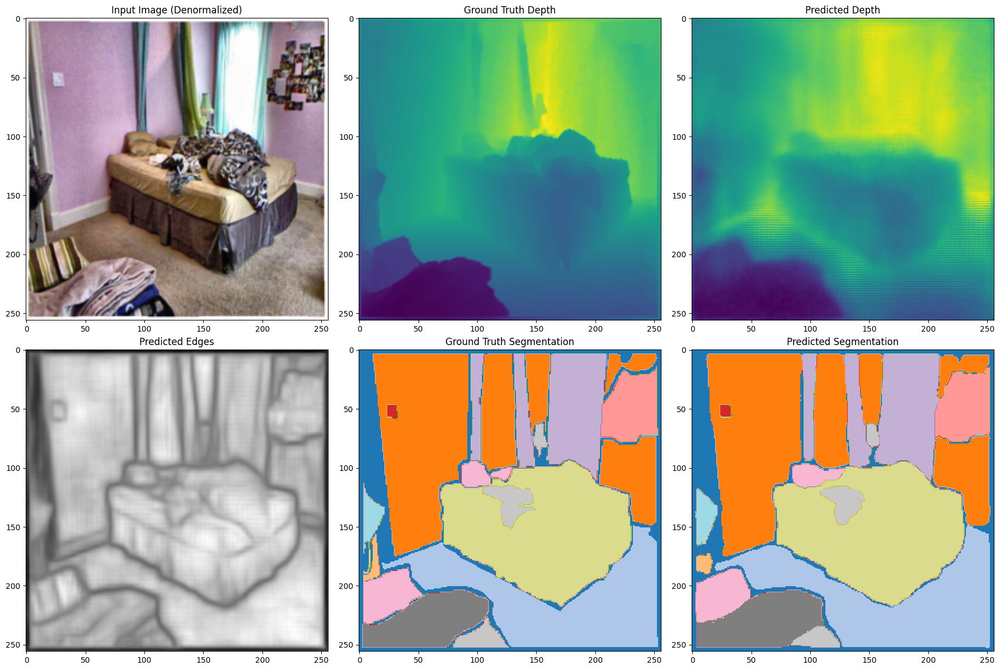

Sample 13:


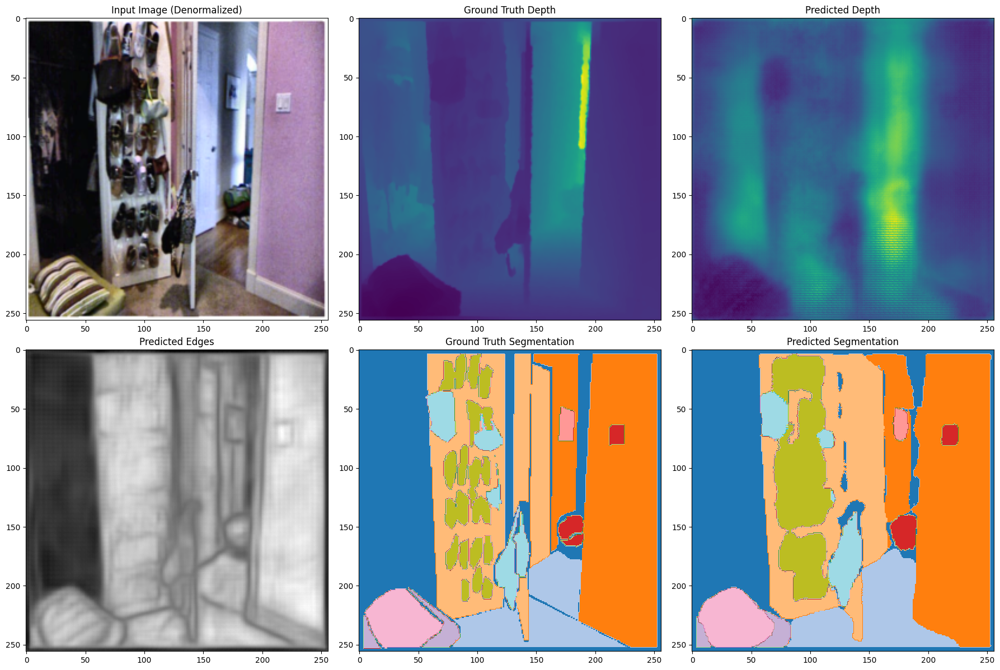

Sample 14:


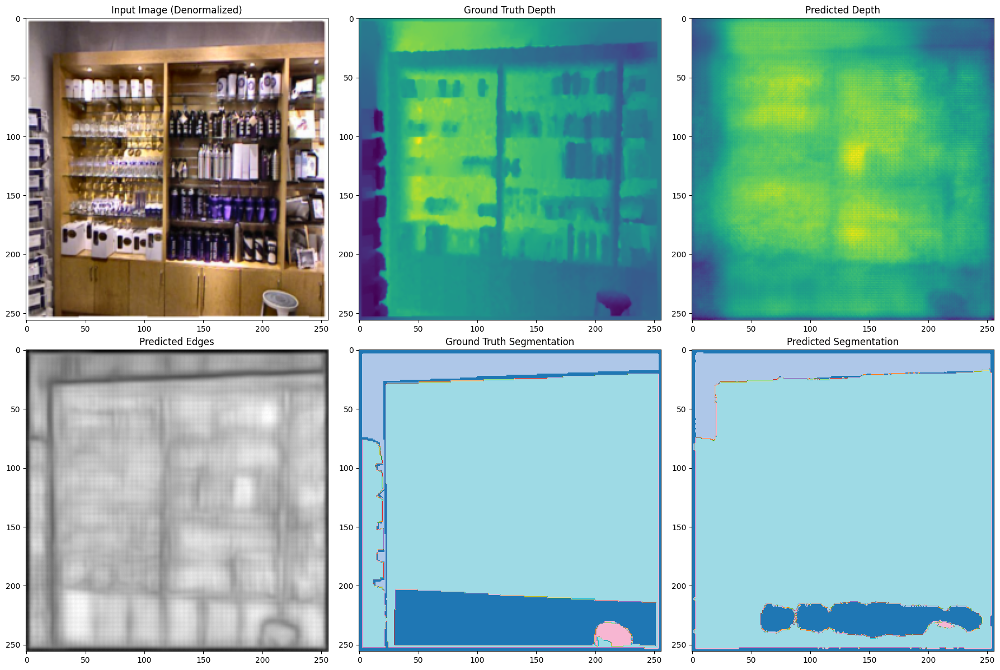

In [125]:
for i in  range(100):
    print(f"Sample {i}:")
    visualize_predictions(full_mti_net, dataset, idx=i)


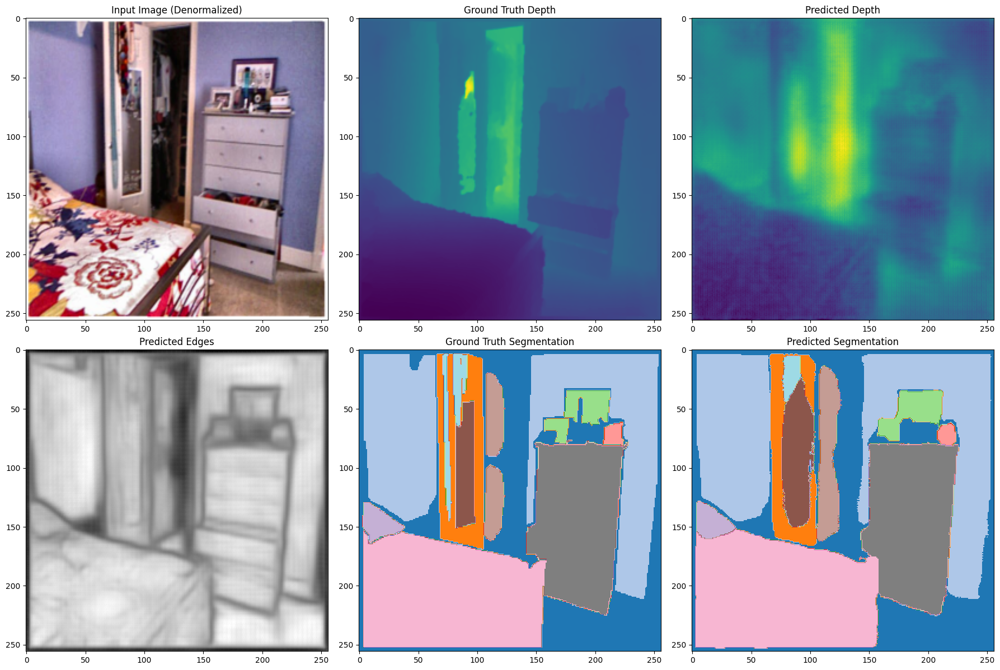

In [83]:
visualize_predictions(full_mti_net, dataset, idx=7)


#Testing


In [111]:
test_dataset = NYUDv2Dataset(root_dir='nyu-organised', split='test', transform=transform)

test_loader = DataLoader(
    test_dataset,
    batch_size=16,
    shuffle=False,
    num_workers=4
)

print(f"Test set size: {len(test_dataset)} samples")

Test set size: 218 samples


In [93]:
def compute_pixel_accuracy(pred, target):
    correct = (pred == target).sum().item()
    total = target.numel()
    return correct / total


In [102]:
def evaluate_segmentation_full(model, val_loader, num_classes=256):
    model.eval()
    total_iou = 0.0
    total_pixel_accuracy = 0.0

    with torch.no_grad():
        for val_images, _, val_labels in val_loader:
            val_images, val_labels = val_images.to(device), val_labels.to(device)
            _, segmentation_output, _ = model(val_images)
            pred_labels = torch.argmax(segmentation_output, dim=1)

            # Compute IoU and Pixel Accuracy
            total_iou += compute_iou(pred_labels, val_labels, num_classes)
            total_pixel_accuracy += compute_pixel_accuracy(pred_labels, val_labels)

    avg_iou = total_iou / len(val_loader)
    avg_pixel_accuracy = total_pixel_accuracy / len(val_loader)
    print(f"Segmentation Accuracy: {avg_pixel_accuracy:.4f}")
    return avg_pixel_accuracy

Segmentation Accuracy: 0.6217


In [112]:
import torch
import torch.nn.functional as F

def evaluate_depth_metrics(pred, target):

    pred = pred.view(-1)
    target = target.view(-1)

    valid_mask = target > 0
    pred = pred[valid_mask]
    target = target[valid_mask]

    # Mean Absolute Error (MAE)
    mae = torch.mean(torch.abs(pred - target)).item()

    # Root Mean Squared Error (RMSE)
    rmse = torch.sqrt(torch.mean((pred - target) ** 2)).item()


    # Threshold Accuracy (delta)
    threshold = torch.max(pred / target, target / pred)
    delta_1 = (threshold < 1.25).float().mean().item()
    delta_2 = (threshold < 1.25 ** 2).float().mean().item()
    delta_3 = (threshold < 1.25 ** 3).float().mean().item()

    return {
        "MAE": mae,
        "RMSE": rmse,
        "Delta 1": delta_1,
        "Delta 2": delta_2,
        "Delta 3": delta_3
    }


In [113]:
def evaluate_depth(model, val_loader):
    model.eval()
    total_metrics = {
        "MAE": 0.0,
        "RMSE": 0.0,
        "Delta 1": 0.0,
        "Delta 2": 0.0,
        "Delta 3": 0.0
    }
    num_samples = 0

    with torch.no_grad():
        for images, depths, _ in val_loader:
            images, depths = images.to(device), depths.to(device)
            depth_output, _, _ = model(images)
            depth_output = F.interpolate(depth_output, size=depths.shape[-2:], mode="bilinear", align_corners=False).squeeze(1)

            metrics = evaluate_depth_metrics(depth_output, depths)

            for key in total_metrics:
                total_metrics[key] += metrics[key]
            num_samples += 1

    # Average metrics across all samples
    for key in total_metrics:
        total_metrics[key] /= num_samples

    print(f"Depth Evaluation Metrics: {total_metrics}")
    return total_metrics


In [114]:
final_pixel_accuracy_segmentation = evaluate_segmentation_full(full_mti_net, val_loadr)
final_pixel_accuracy_depth = evaluate_depth(full_mti_net, val_loader)
final_pixel_accuracy_segmentation, final_pixel_accuracy_depth

Segmentation Accuracy: 0.5825
Depth Evaluation Metrics: {'MAE': 0.032346759124525955, 'RMSE': 0.041637487177337916, 'Delta 1': 0.4127149816070284, 'Delta 2': 0.668275168963841, 'Delta 3': 0.8077370524406433}


(0.5824851308550153,
 {'MAE': 0.032346759124525955,
  'RMSE': 0.041637487177337916,
  'Delta 1': 0.4127149816070284,
  'Delta 2': 0.668275168963841,
  'Delta 3': 0.8077370524406433})